In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

In [ ]:
image=cv2.imread('image.jpg')
#print(image.shape) #(1200, 1920, 3)
#cv2_imshow(image)#----> (x,y,z) : x,y-row and columns & z- channels in picture (RBG)

# **Image Conversion**

In [ ]:
image=cv2.imread('image.jpg')
# cvtColor() <--- It is a image color converter 
#BGR to Gray
gray=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY) #no channel
g=cv2.cvtColor(gray,cv2.COLOR_GRAY2BGR) #only for displaying beacuse hstack cannot display (dif channel images)
#cv2_imshow(gray)
#BGR to HSV
HSV=cv2.cvtColor(image,cv2.COLOR_BGR2HSV) #has also 3 channel but it has all channels in H only
#cv2_imshow(HSV) #print(HSV.shape) #cv2_imshow()
res=np.hstack((image,g,HSV));cv2_imshow(res)

# **IMAGE COLOR PROFILE**

In [ ]:
canny_image=cv2.Canny(gray,150,150) #to convert gray image to edge image
#cv2_imshow(canny_image)
matrixx=np.ones((6,6),np.uint8)   #matrix [[1 1 1 1 1]
                                       # [1 1 1 1 1]
                                       # [1 1 1 1 1]
                                       # [1 1 1 1 1]
                                       # [1 1 1 1 1]]
print(matrixx)

[[1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]]


# **EdgeDetection**

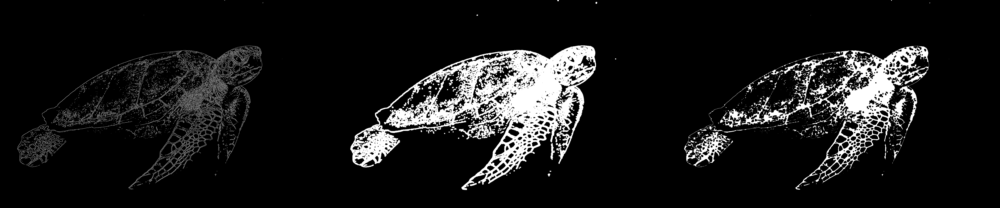

In [ ]:
dilate_image=cv2.dilate(canny_image,matrixx,iterations=1) # DILATION --> for increase size of edge image
#cv2_imshow(dilate_image)
erode_image=cv2.erode(dilate_image,matrixx,iterations=1) #errosion --> for reduce size of edge image
#cv2_imshow(erode_image)
compare=np.hstack((canny_image,dilate_image,erode_image))  #hstack of numpy to view in horizontally
cv2_imshow(compare)

# **IMAGE MANIPULATION NOISE REDUCTION**

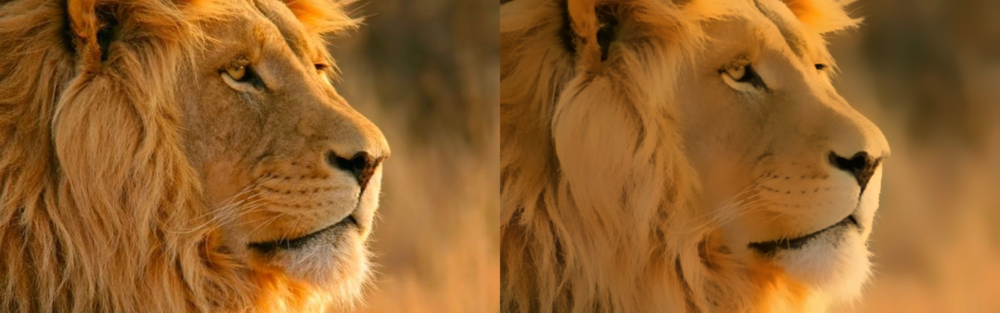

In [ ]:
image1=cv2.imread('lion.jpg')
#cv2_imshow(image1)
display=cv2.fastNlMeansDenoisingColored(image1,None,20,20,3,50) # function to remove grains in image
dst=np.hstack((image1,display)) #horizontal stack
cv2_imshow(dst) 

# **Drawing Shapes & Text**

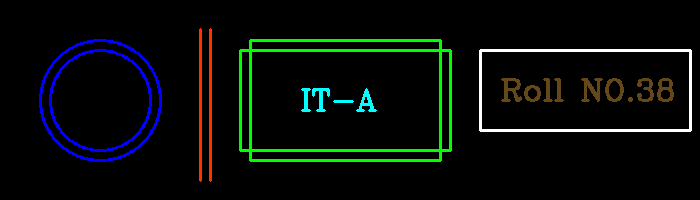

In [ ]:
# zero --> means in open cv is black color
img=np.zeros((200,700,3),np.uint8);image=img.copy() # for black color image of size (512,512
#np.uint8 --> means value should be updates in range (0,255) i.e color range #cv2_imshow(img)
cv2.circle(img,(100,100),50,(255,0,0),2);cv2.circle(img,(100,100),60,(255,0,0),2) #circle-image,center,radius,color(B,G,R),thickness
cv2.rectangle(img,(450,50),(240,150),(0,255,0),2);cv2.rectangle(img,(440,40),(250,160),(0,255,0),2) #rectangle
cv2.line(img,(200,180),(200,29),(0,50,255),2);cv2.line(img,(210,180),(210,29),(0,50,255),2) #line
cv2.putText(img,"Roll NO.38",(500,100),cv2.FONT_HERSHEY_COMPLEX,1,(25,72,100),2);cv2.putText(img,"IT-A",(300,110),cv2.FONT_HERSHEY_COMPLEX,1,(255,255,0),2)
cv2.rectangle(img,(690,50),(480,130),(255,255,255),2) #res=np.vstack((image,img))
cv2_imshow(img)

# **Image Filter (By Color)**

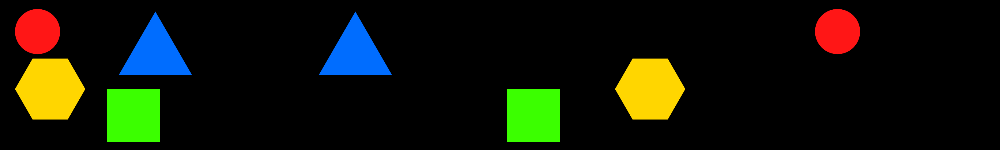

In [ ]:
img=cv2.imread('shapes.png');HSV=cv2.cvtColor(img,cv2.COLOR_BGR2HSV);gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
#Yellow
lower_range=np.array([1,0,0]);higher_range=np.array([46,255,255]);squr1=cv2.inRange(HSV,lower_range,higher_range)
#Green
lower_range=np.array([46,0,0]);higher_range=np.array([90,255,255]);squr2=cv2.inRange(HSV,lower_range,higher_range)
#Blue
lower_range=np.array([96,0,0]);higher_range=np.array([200,255,255]);squr3=cv2.inRange(HSV,lower_range,higher_range)
#RED
lower_range=np.array([0,0,0]);higher_range=np.array([20,255,255]);squr4=cv2.inRange(HSV,lower_range,higher_range)
res1=cv2.bitwise_and(img,img,mask=squr1);res2=cv2.bitwise_and(img,img,mask=squr2);res3=cv2.bitwise_and(img,img,mask=squr3);res4=cv2.bitwise_and(img,img,mask=squr4)
r=np.hstack((img,res3,res2,res1,res4));cv2_imshow(r)

# **Face Detection**



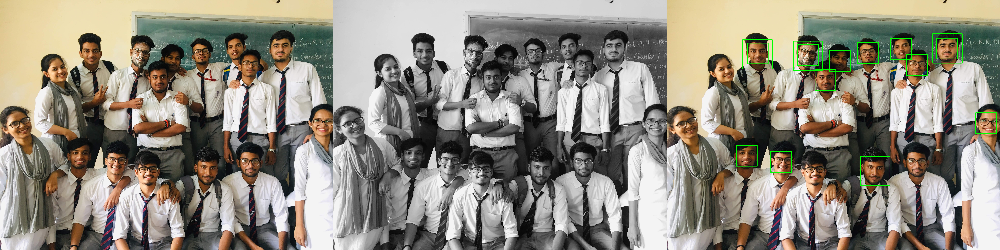

In [ ]:
img=cv2.imread('/content/IMG_1763.JPG')
image=cv2.imread('/content/IMG_1763.JPG')
face_dect=cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
gray=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
faces=face_dect.detectMultiScale(gray,1.4,4)
for (x,y,h,w) in faces:
  cv2.rectangle(image,(x,y),(x+h,y+w),(0,255,0),10)
g=cv2.cvtColor(gray,cv2.COLOR_GRAY2BGR)
res=np.hstack((img,g,image))
cv2_imshow(res)

# **Shape Detection**

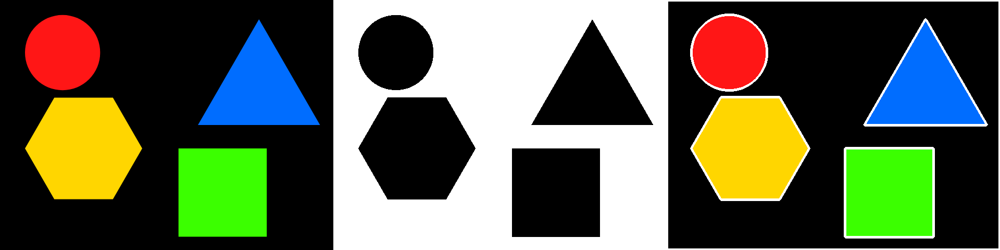

We found a square


In [ ]:
img = cv2.imread("shapes.png");l=[]
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
ret, thresh = cv2.threshold(gray,50,255,1);th=cv2.cvtColor(thresh,cv2.COLOR_GRAY2BGR)
contours,h = cv2.findContours(thresh,1,2) # cv2_imshow(thresh)
for cnt in contours:
  approx = cv2.approxPolyDP(cnt,0.01*cv2.arcLength(cnt,True),True)
                                  #for error                 #for closed curve
  #print(len(approx))----------4-rectangle #6-hexagone #3-triangle #16-circle #4-whole background image
  n=len(approx)
  if n==6:l.append("We have a hexagon here");cv2.drawContours(img,[cnt],0,(255,255,255),3) # this is a hexagon
  elif n==3:l.append("We found a triangle");cv2.drawContours(img,[cnt],0,(255,255,255),3) # this is a triangle  
  elif n>9:l.append("We found a circle");cv2.drawContours(img,[cnt],0,(255,255,255),3) # this is a circle
  elif n==4:l.append("We found a square");cv2.drawContours(img,[cnt],0,(255,255,255),3) # this is a Square 
image = cv2.imread("shapes.png");res=np.hstack((image,th,img));cv2_imshow(res);print(*l[:1],sep='\n') #print(len(cnt)) 

# **Name Of Shape:Detection**

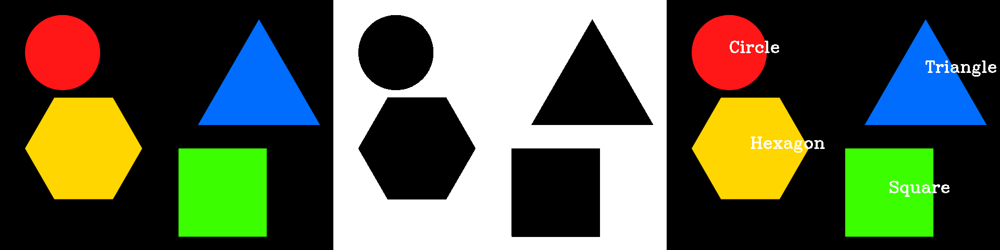

In [ ]:
img = cv2.imread("shapes.png");l=[];gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
ret, thresh = cv2.threshold(gray,40,255,1);th=cv2.cvtColor(thresh,cv2.COLOR_GRAY2BGR) #cv2_imshow(thresh)
contours,h = cv2.findContours(thresh,1,2) # cv2_imshow(thresh) #print(contours[4])
for j in range (len(contours)-1):
  s_x=0;s_y=0;ln=len(contours[j])
  for i in range (ln):
    s_x+=contours[j][i][0][0];s_y+=contours[j][i][0][1] #co-ordinates by contour
  x_axis=(s_x//(ln//2))//2;y_axis=(s_y//(ln//2))//2;cnt = contours[j] #print(x_axis,y_axis) #mid_point of co-ordinates given by contour
  approx = cv2.approxPolyDP(cnt,0.01*cv2.arcLength(cnt,True),True)
                                  #for error                 #for closed curve
  #print(len(approx))----------4-rectangle #6-hexagone #3-triangle #16-circle #4-whole background image
  n=len(approx)
  if n==6:cv2.putText(img,"Hexagon",(x_axis,y_axis),cv2.FONT_HERSHEY_COMPLEX,1,(255,255,255),2)# this is a hexagon
  elif n==3:cv2.putText(img,"Triangle",(x_axis,y_axis),cv2.FONT_HERSHEY_COMPLEX,1,(255,255,255),2) # this is a triangle  
  elif n>9:cv2.putText(img,"Circle",(x_axis,y_axis),cv2.FONT_HERSHEY_COMPLEX,1,(255,255,255),2) # this is a circle
  elif n==4:cv2.putText(img,"Square",(x_axis,y_axis),cv2.FONT_HERSHEY_COMPLEX,1,(255,255,255),2)# this is a Square
  elif n==5:cv2.putText(img,"Pentagoan",(x_axis,y_axis),cv2.FONT_HERSHEY_COMPLEX,1,(255,255,255),2)# this is a pantagoan
  elif n==2:cv2.putText(img,"Line",(x_axis,y_axis),cv2.FONT_HERSHEY_COMPLEX,1,(255,255,255),2)# this is a line
image = cv2.imread("shapes.png");res=np.hstack((image,th,img));cv2_imshow(res)

In [ ]:
from IPython.display import HTML
from base64 import b64encode